# ipynb-файл:
- Создать несколько типичных запросов к БД, на которых можно было бы увидеть основные возможности выборки данных, желательно с использованием NumPy, Pandas, Matplotlib и т.п..
Например:
- статистика ссылок по доменам
- поиск дубликатов ссылок

In [9]:
import os
import sqlite3
from prettytable import from_db_cursor

db_name = os.path.join("db", 'temp_SQLite.db')
db = sqlite3.connect(db_name)
cur = db.cursor()
cur.execute("SELECT * FROM urls")
from_db_cursor(cur)

+----+---------------------------+--------+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [10]:
import numpy
import pandas
import matplotlib

df = pandas.read_sql_query("SELECT * FROM urls", db)
df.head()

,id,url_name,status,screenshot
0,1,https://www.ozon.ru/,403,0
1,2,https://www.avito.ru/,403,0
2,3,https://2gis.ru/,403,0
3,4,https://www.imdb.com/,403,0
4,5,https://ya.ru/,200,iVBORw0KGgoAAAANSUhEUgAABOEAAATfCAYAAABEVeM2AA...


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11 entries, 0 to 10
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   id          11 non-null     int64 
 1   url_name    11 non-null     object
 2   status      11 non-null     int64 
 3   screenshot  11 non-null     object
dtypes: int64(2), object(2)
memory usage: 480.0+ bytes


In [12]:
print(df.count())

id            11
url_name      11
status        11
screenshot    11
dtype: int64


In [13]:
df.url_name.value_counts()

https://market.yandex.ru/    3
https://www.imdb.com/        1
https://www.avito.ru/        1
https://www.kinopoisk.ru/    1
https://www.gosuslugi.ru/    1
https://2gis.ru/             1
https://ya.ru/               1
https://www.ozon.ru/         1
https://www.mos.ru/          1
Name: url_name, dtype: int64

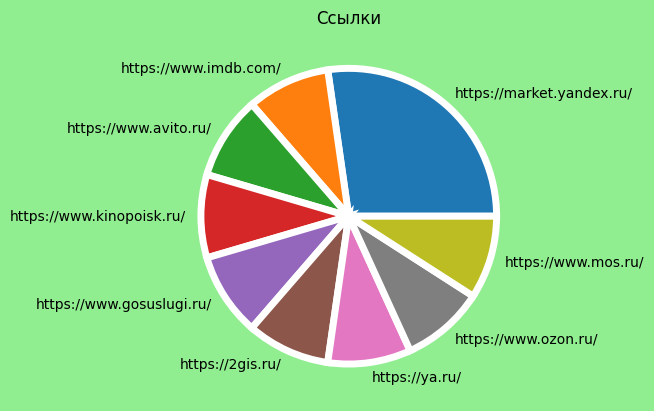

In [14]:
import matplotlib.pyplot as plt

dict_df = dict(df.url_name.value_counts())

labels = dict_df.keys()
values = dict_df.values()

fig, ax = plt.subplots()
fig.set_facecolor('lightgreen')
ax.set_title('Ссылки')
ax.pie(values, labels=labels, wedgeprops={"linewidth": 5, "edgecolor":'white'})
plt.show()

In [15]:
# Поиск дубликатов ссылок
df[df.url_name.duplicated()]


,id,url_name,status,screenshot
7,8,https://market.yandex.ru/,200,iVBORw0KGgoAAAANSUhEUgAABOEAAATfCAYAAABEVeM2AA...
8,9,https://market.yandex.ru/,200,iVBORw0KGgoAAAANSUhEUgAABOEAAATfCAYAAABEVeM2AA...


In [16]:
db.close()